# Metrics Validation. Dataset with 2 Lifts. 
## Base lift for metrics calculation is the one on which models were trained  

Metric compuation procedure is described in [Metric for evaluating difference between seismograms](./Metrics_study_intro.ipynb)

In [1]:
import sys
sys.path.append('..')

from functools import reduce

import pandas as pd

from seismicpro.batchflow import Dataset
from seismicpro.src import SeismicBatch, FieldIndex

from utils import get_cv, draw_modifications_dist, get_modifications_list, validate_all

## Data Download

In [2]:
!ls /data/multiple_lift_4_metrics_validation/QC

1_1dUnet_nomask.sgy  1_ibm_sup.sgy    1_lift.sgy     1_raw.sgy
1_1dUnet.sgy	     1_ibm_unsup.sgy  1_lift_v1.sgy  README


In [3]:
base_path = '/data/multiple_lift_4_metrics_validation/QC/' 
paths = {
    'lift': '1_lift.sgy',
    'lift_v1': '1_lift_v1.sgy',
    'raw': '1_raw.sgy',
    'm_1': '1_1dUnet_nomask.sgy',
    'm_2': '1_1dUnet.sgy',
    'm_3': '1_unsup.sgy',
    'm_4': '1_sup.sgy',
}

In [4]:
field_index = reduce(lambda x, y: x.merge(y), 
                     (FieldIndex(name=name, path=base_path+path, extra_headers=['offset']) for name, path in paths.items()))

In [5]:
batch = (Dataset(field_index, SeismicBatch)
         .next_batch(len(field_index))
         .load(fmt='segy', components=tuple(paths.keys())))

cv = get_cv([batch.__getattr__(c)[0] for c in batch.components])

### Fields number in data

In [6]:
len(field_index)

11

## Metrics calculation with 1_lift.sgy as base

In [7]:
res = validate_all(batch)
pd.DataFrame(res)

,LIFT_V1_amp,LIFT_V1_ph,LIFT_amp,LIFT_ph,M_1_amp,M_1_ph,M_2_amp,M_2_ph,M_3_amp,M_3_ph,M_4_amp,M_4_ph,RAW_amp,RAW_ph
0,6.873391,45.381878,0.0,0.0,41.144688,69.271881,3.417942,24.923088,67.816833,73.344292,9.655366,61.806057,456.683655,50.852352
1,2.257816,45.798195,0.0,0.0,9.004299,68.216515,1.529928,23.805405,8.256458,74.212158,3.611828,63.444859,81.794449,52.348915
2,3.001026,45.403870,0.0,0.0,8.348119,66.219673,1.630319,21.041836,11.241213,70.616623,3.681849,59.447731,102.182655,49.714863
3,5.169468,46.406704,0.0,0.0,43.905296,70.361847,2.576187,26.380930,68.439301,73.794350,6.718940,64.043091,433.403229,53.255947
4,1.982107,44.995804,0.0,0.0,7.406431,69.772850,1.342990,24.016029,9.294025,73.885048,3.841424,65.381966,103.582253,54.237503
5,3.727628,46.921051,0.0,0.0,8.957015,65.250427,1.676803,21.845270,18.303514,75.048958,4.543062,63.054775,105.778435,51.401287
6,4.394864,46.386887,0.0,0.0,20.999615,70.812210,1.980179,25.512449,51.770702,74.185890,5.686204,65.022820,283.429962,53.638859
7,1.496290,44.435482,0.0,0.0,22.184023,66.162148,1.096776,26.302259,17.291901,76.444420,3.682863,67.252533,180.119263,55.900738
8,1.872853,42.035236,0.0,0.0,7.780857,65.948959,1.199339,24.684448,28.834984,77.723099,3.600789,68.348686,209.218018,57.334106
9,5.644798,40.823532,0.0,0.0,21.710066,67.255814,3.296587,20.726377,30.743288,71.403526,9.186719,59.989822,120.295143,48.187084


Field 0


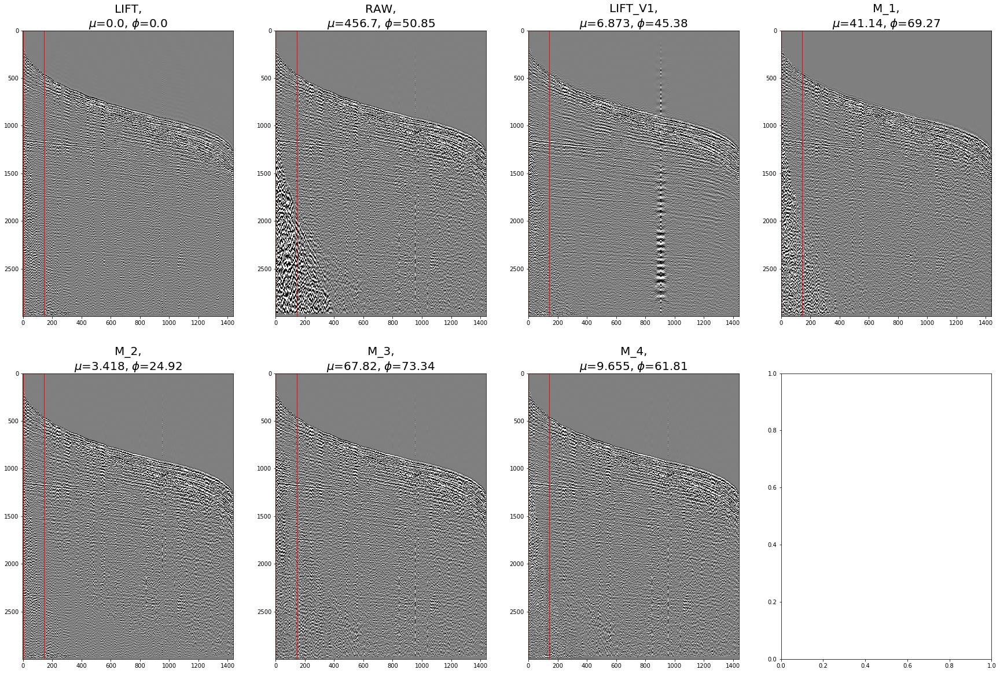

In [8]:
i=0
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 1


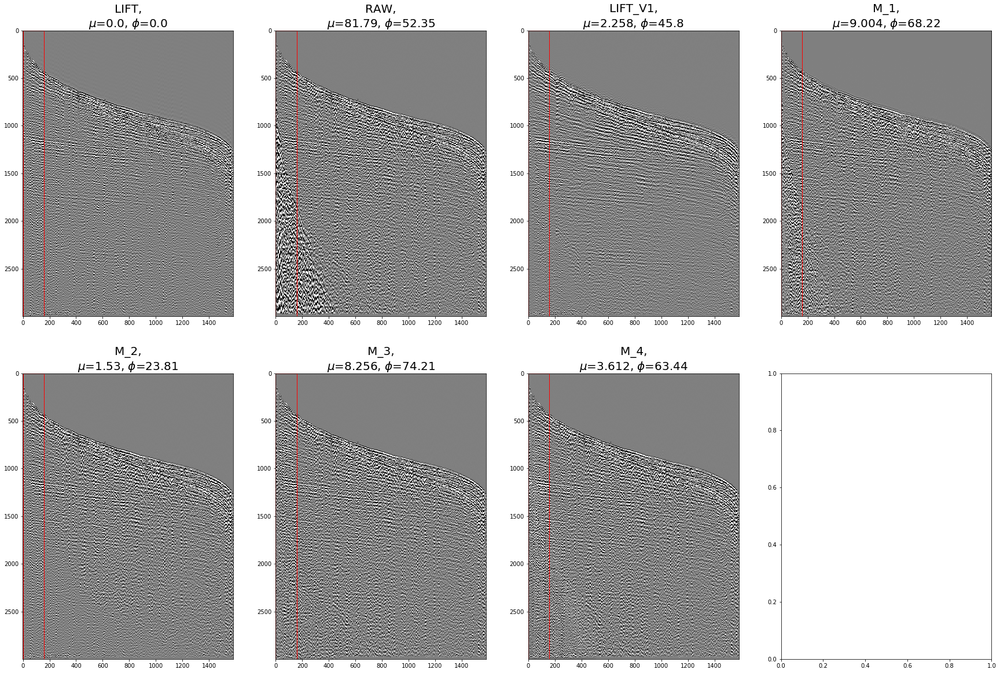

In [9]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 2


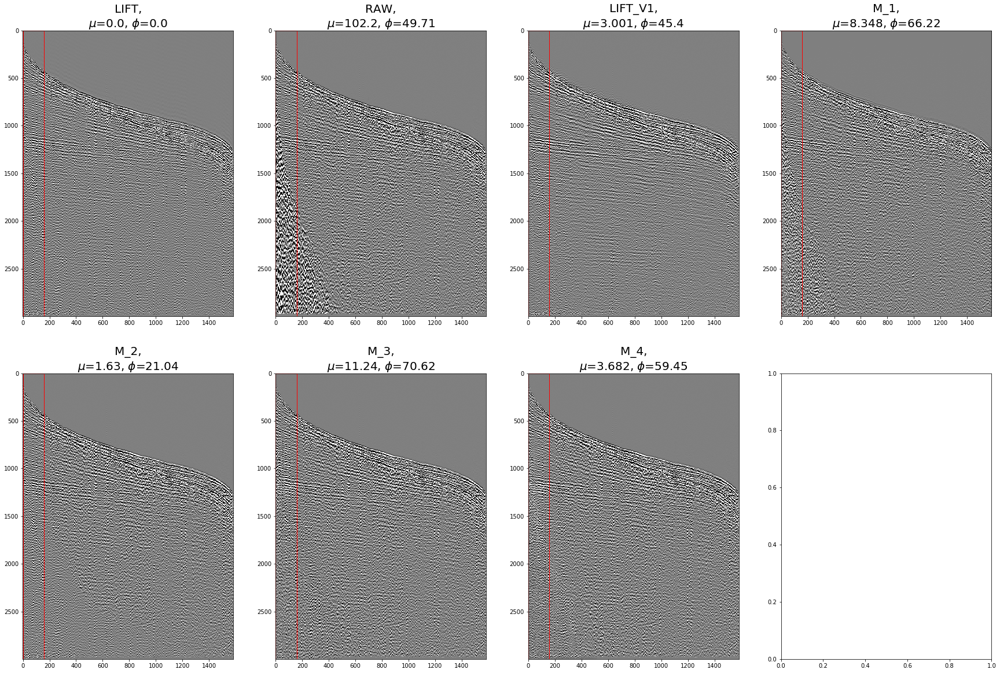

In [10]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 3


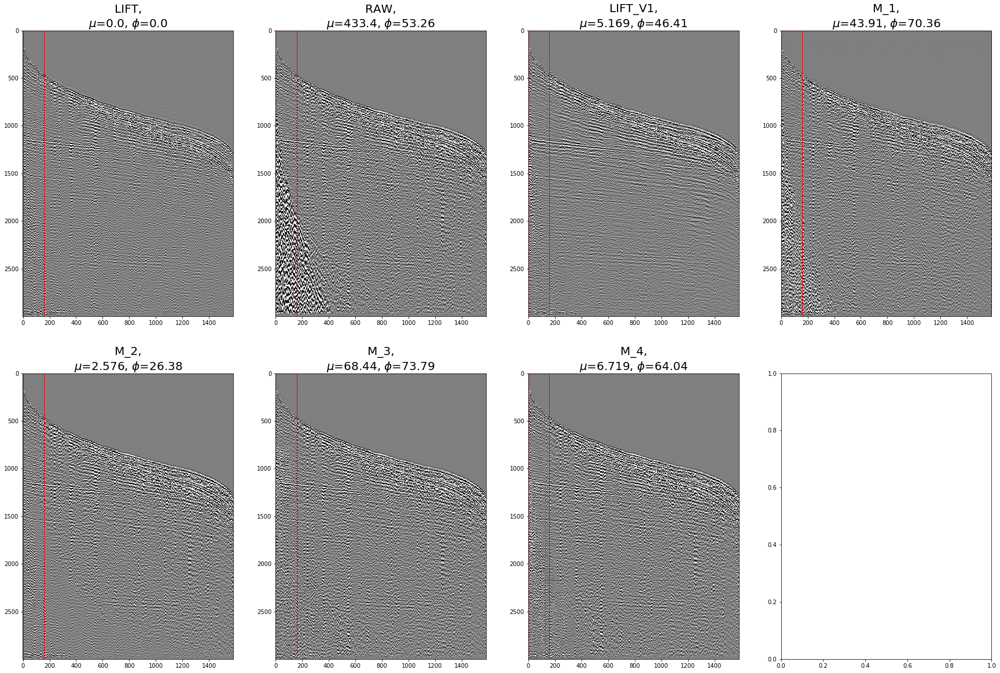

In [11]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 4


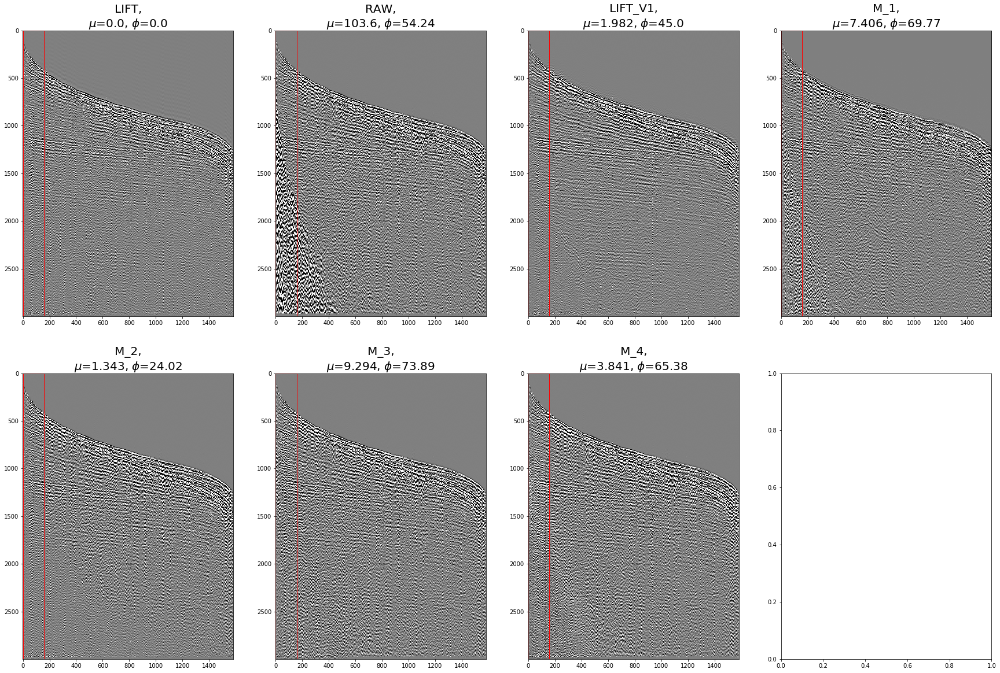

In [12]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 5


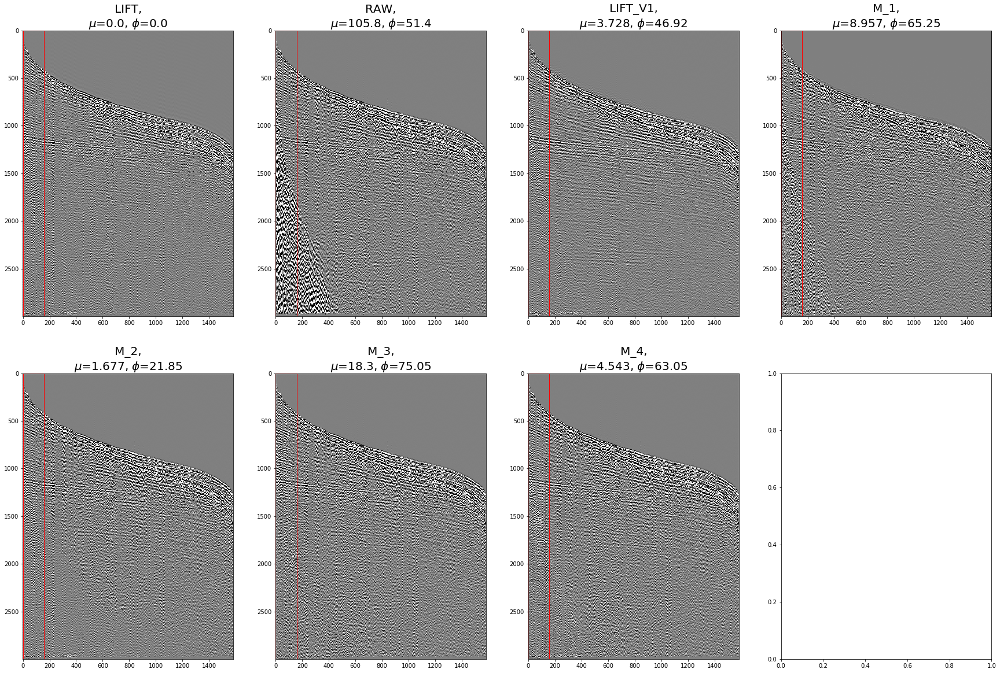

In [13]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 6


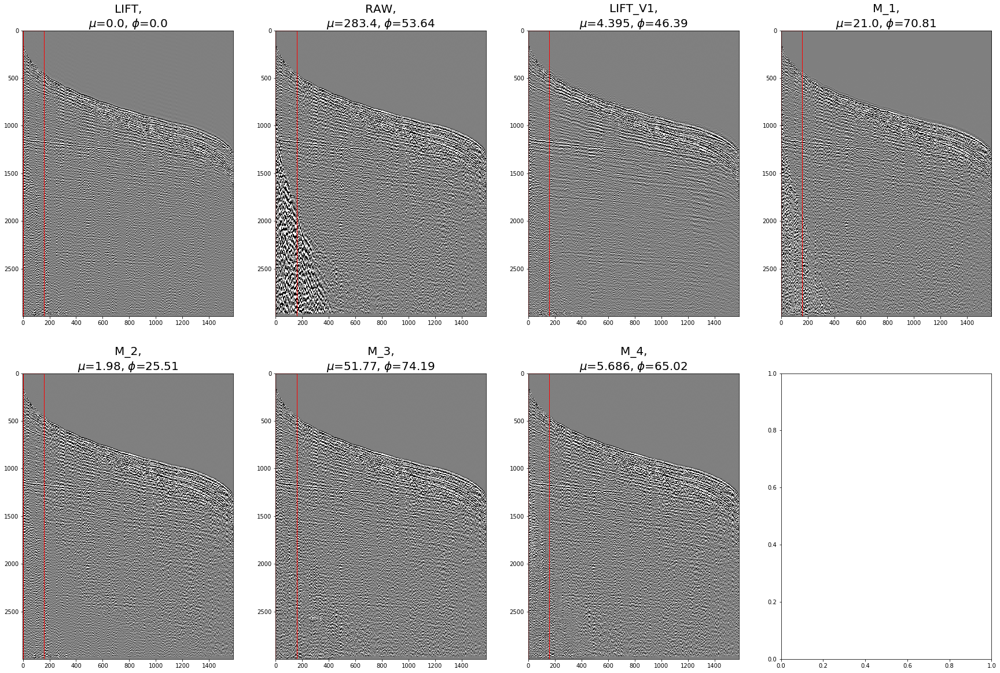

In [14]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 7


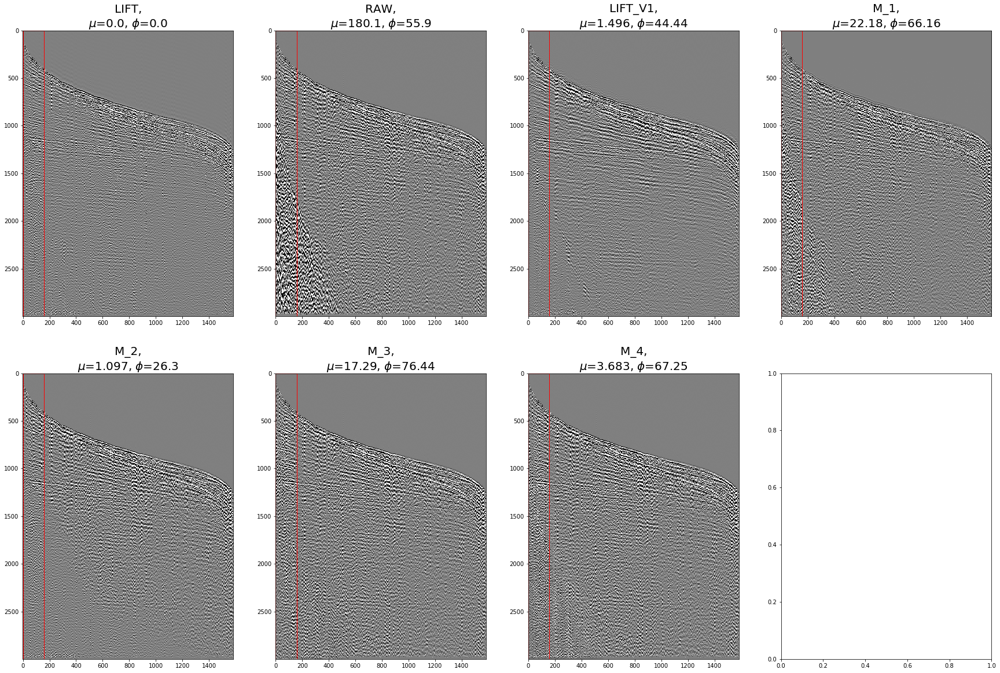

In [15]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 8


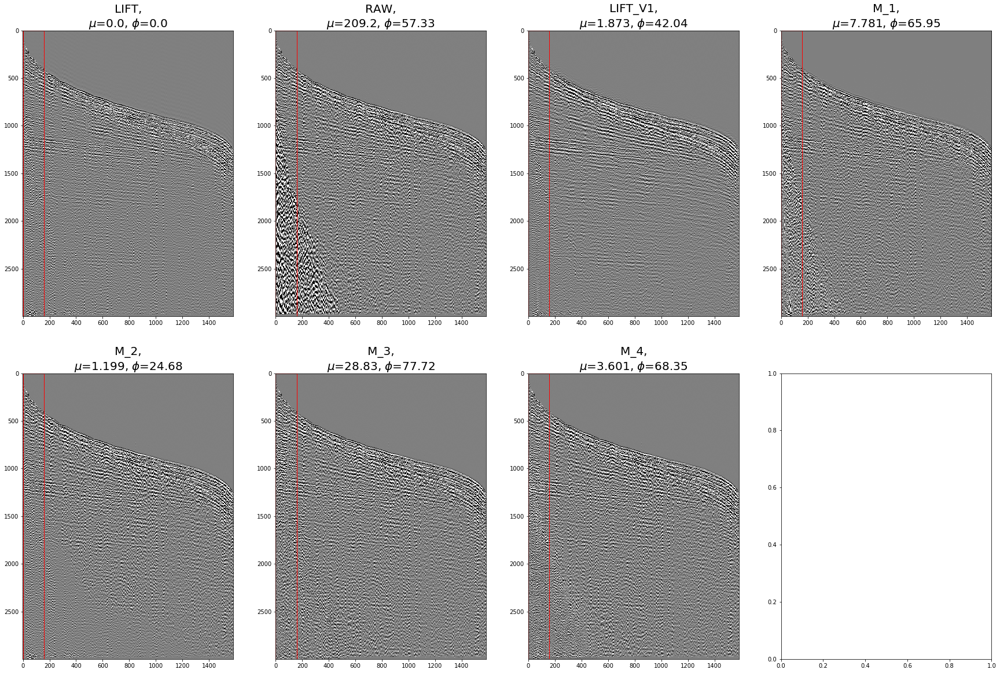

In [16]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 9


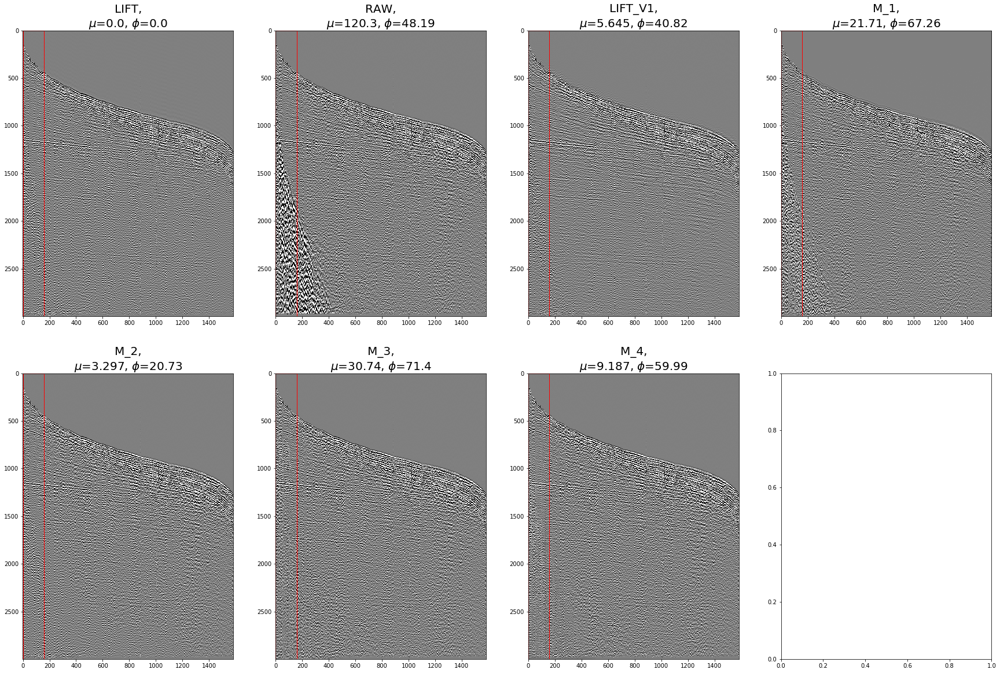

In [17]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1

Field 10


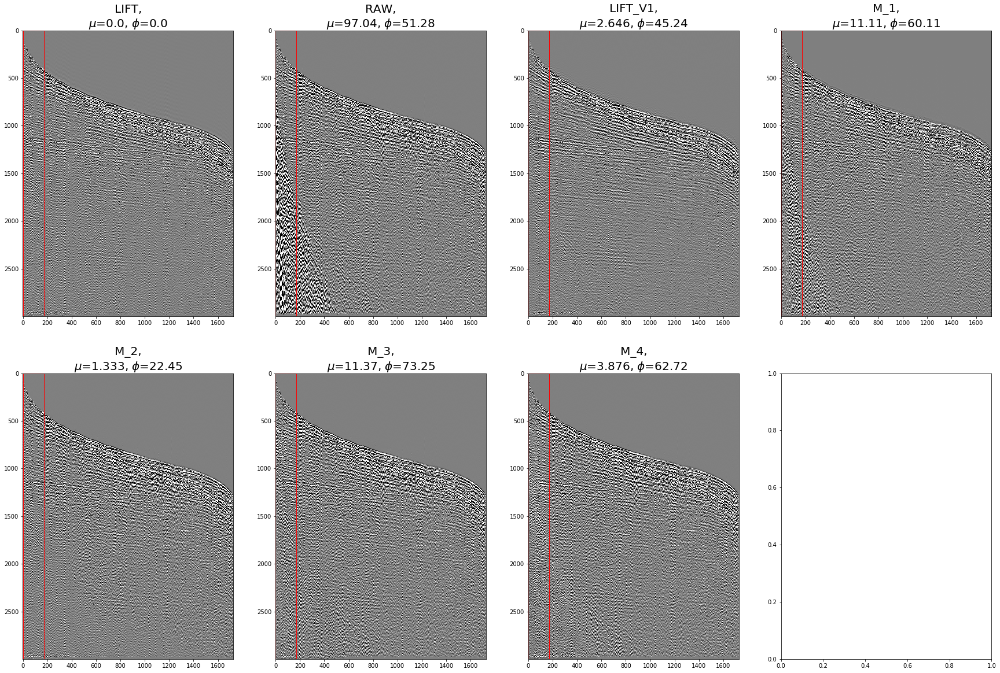

In [18]:
print('Field {}'.format(i))
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv, window='boxcar',  figsize=(30, 20), n_cols=4, aspect='auto')
i+=1